Resourses Used: 
- [Original GAN paper](https://https://arxiv.org/pdf/1406.2661.pdf) and [DCGAN Paper](https://https://arxiv.org/pdf/1511.06434.pdf)
- [CS236g Standford](http://cs236g.stanford.edu/)
- [Pytorch Officail GAN Tutorial](https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html#generative-adversarial-networks)

In [1]:
import torch
import torchvision
from torch import nn
from torchvision import transforms,datasets
from torchvision.utils import make_grid
import torch.utils.data as data
from torch.utils.data import DataLoader
from torch.optim.lr_scheduler import StepLR,ReduceLROnPlateau

import os
import tarfile
import urllib.request
import random
import matplotlib.pyplot as plt
import numpy as np
from tqdm.auto import tqdm
from PIL import Image
import torchvision.utils as vutils

import matplotlib.animation as animation
from IPython.display import HTML

os.makedirs("./ckpts", exist_ok=True)  # Create directory to store model checkpoints
!python --version
print(f"PyTorch {torch.__version__}")
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

Python 3.7.11
PyTorch 1.9.0+cu102


In [2]:
hyper_param = {
    "batch_size": 128,
    "num_channels" : 1,
    "z_dim" : 100,
    "gen_featmap": 64,
    "disc_featmap": 64,
    "num_epochs" : 30,
    "lr" : 0.0002,
    "adam_beta1" : 0.5,
    "adam_beta2" : 0.999,
    "display_step": 500

}

# Reproducibility
Goal: Limit the number of non-determinstic behaviour to yield reproducibility<br>
https://pytorch.org/docs/stable/notes/randomness.html

In [3]:
seed = 0
random.seed(seed)
torch.manual_seed(seed)
torch.cuda.manual_seed(seed)
np.random.seed(seed)
torch.backends.cudnn.deterministic = True

# DataSet and DataLoader

In [4]:

transform = transforms.Compose([transforms.ToTensor()])

train_dataset = datasets.MNIST(root ="./data",train=True,download=True,transform = transform)
train_loader = DataLoader(train_dataset,batch_size=hyper_param["batch_size"],shuffle=True)

test_dataset = datasets.MNIST(root ="./data",train=False,download=True,transform = transform)
test_loader = DataLoader(test_dataset,batch_size=1,shuffle=False)


Extracting ./data/MNIST/raw/train-images-idx3-ubyte.gz to ./data/MNIST/raw




Extracting ./data/MNIST/raw/train-labels-idx1-ubyte.gz to ./data/MNIST/raw




Extracting ./data/MNIST/raw/t10k-images-idx3-ubyte.gz to ./data/MNIST/raw




Extracting ./data/MNIST/raw/t10k-labels-idx1-ubyte.gz to ./data/MNIST/raw



/usr/local/lib/python3.7/dist-packages/torchvision/datasets/mnist.py:498: UserWarning: The given NumPy array is not writeable, and PyTorch does not support non-writeable tensors. This means you can write to the underlying (supposedly non-writeable) NumPy array using the tensor. You may want to copy the array to protect its data or make it writeable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at  /pytorch/torch/csrc/utils/tensor_numpy.cpp:180.)
  return torch.from_numpy(parsed.astype(m[2], copy=False)).view(*s)


# Visualize the Real Images

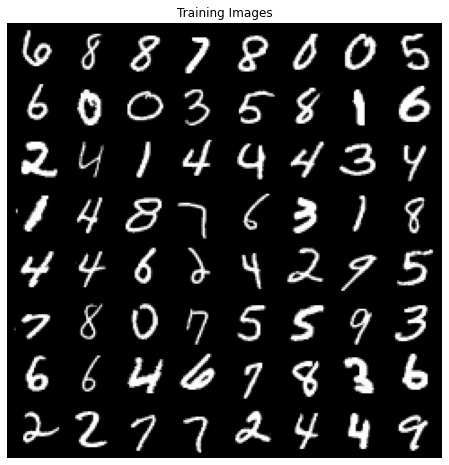

In [5]:
real_batch = next(iter(train_loader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)));

# Generator 

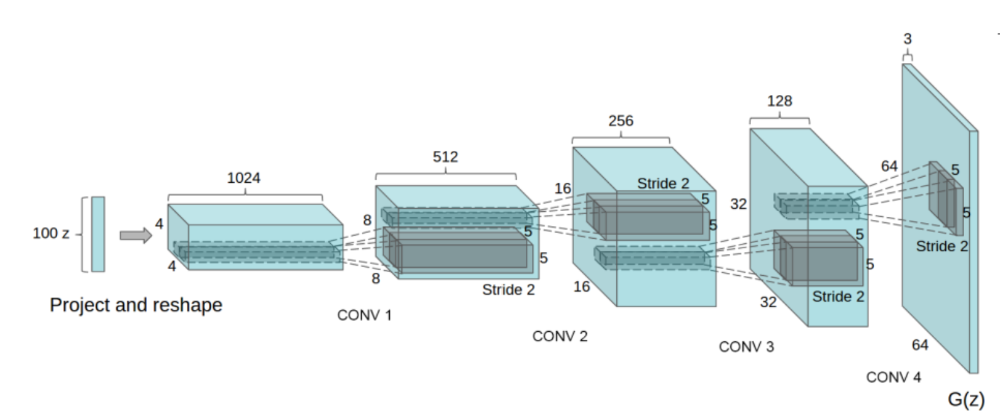

In [47]:
class Generator(nn.Module):
  def __init__(self,nz=100):
    super(Generator,self).__init__()
    self.nz= hyper_param["z_dim"]#size of latent vector z
    hidden = hyper_param["gen_featmap"]
    image_channel = hyper_param["num_channels"]
    self.gen = nn.Sequential(
            self.gen_block(self.nz, hidden * 4),
            self.gen_block(hidden * 4, hidden * 2,kernel_size=4,stride=1),
            self.gen_block(hidden * 2, hidden),
            self.gen_block(hidden, image_channel, kernel_size=4, final_layer=True),
        )
  def gen_block(self,in_channels,out_channels,kernel_size=3,stride=2,padding=0,final_layer=False):
    if not final_layer:
      return nn.Sequential(
                nn.ConvTranspose2d(in_channels, out_channels, kernel_size, stride,padding,bias=False),
                nn.BatchNorm2d(out_channels),
                nn.ReLU(inplace=True),
            )
    else: # Final Layer
      return nn.Sequential(
                nn.ConvTranspose2d(in_channels, out_channels, kernel_size, stride,padding),
                nn.Tanh(),
            )
  
  def forward(self,noise):
    #assert noise.shape[2:] == (1,1) ## noise shape should be (batchsize,z_dim,1,1)
    return self.gen(noise)


In [7]:
class Discriminator(nn.Module):
  def __init__(self):
    super(Discriminator,self).__init__()
    image_channel = hyper_param["num_channels"]
    hidden = hyper_param["disc_featmap"]
    self.disc = nn.Sequential(
        self.disc_block(image_channel,hidden),
        self.disc_block(hidden,hidden*2),
        self.disc_block(hidden*2,1,final_layer=True),
    )
    


  def disc_block(self,in_channels,out_channels,kernel_size=4,stride=2,padding=0,final_layer=False):
    
    if not final_layer:
      return nn.Sequential(
                nn.Conv2d(in_channels, out_channels, kernel_size, stride,padding,bias=False),
                nn.BatchNorm2d(out_channels),
                nn.LeakyReLU(0.2,inplace=True),
            )
    else: # Final Layer
      return nn.Sequential(
                nn.Conv2d(in_channels, out_channels, kernel_size, stride,padding),
                nn.Sigmoid(),
            )
  
  def forward(self,image):
    pred_prob = self.disc(image)
    return pred_prob.view(len(pred_prob),-1)


# Test Generator output

torch.Size([128, 1, 28, 28])
Nothing Meaningful, Makes sense


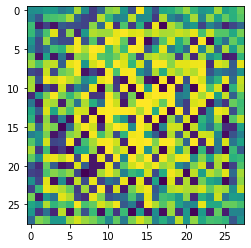

In [51]:
noise = torch.randn(128,100,1,1) #(batch,z_dim,1,1)
gen_shape_test = Generator()
generated_sample = gen_shape_test(noise)
print(generated_sample.shape)
plt.imshow(np.transpose(generated_sample[0].cpu().detach().numpy(),(1,2,0)).squeeze());
print("Nothing Meaningful, Makes sense")


# Test Discriminator Output

In [9]:
real_batch = next(iter(train_loader))
disc = Discriminator()
pred_prob = disc(real_batch[0])
print(pred_prob.shape)
print(f"First 5 sample's prediction: {pred_prob[:5].detach()}\n discriminator is randomly gussing,makes sense")

torch.Size([128, 1])
First 5 sample's prediction: tensor([[0.5128],
        [0.5913],
        [0.4928],
        [0.6900],
        [0.6534]])
 discriminator is randomly gussing,makes sense


# Initialize the Network

Intialize the weight according to the paper. Find class name and if Belongs to CONV class then weights intialized Normally with N(0,0.02) and same for batch norm

In [10]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [52]:
gen = Generator().to(device)
disc = Discriminator().to(device)
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

In [50]:
gen

Generator(
  (gen): Sequential(
    (0): Sequential(
      (0): ConvTranspose2d(100, 256, kernel_size=(3, 3), stride=(2, 2), bias=False)
      (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (1): Sequential(
      (0): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(1, 1), bias=False)
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (2): Sequential(
      (0): ConvTranspose2d(128, 64, kernel_size=(3, 3), stride=(2, 2), bias=False)
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (3): Sequential(
      (0): ConvTranspose2d(64, 1, kernel_size=(4, 4), stride=(2, 2))
      (1): Tanh()
    )
  )
)

In [13]:
disc

Discriminator(
  (disc): Sequential(
    (0): Sequential(
      (0): Conv2d(1, 64, kernel_size=(4, 4), stride=(2, 2), bias=False)
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (1): Sequential(
      (0): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), bias=False)
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (2): Sequential(
      (0): Conv2d(128, 1, kernel_size=(4, 4), stride=(2, 2))
      (1): Sigmoid()
    )
  )
)

# Optimizer 

StepLR Scheduler => Decays the learning rate of each parameter group by gamma every step_size epochs.

ReduceLROnPlateau Scheduler => Reduce learning rate when a metric has stopped improving.


In [14]:
beta_1 = hyper_param["adam_beta1"]
beta_2 = hyper_param["adam_beta2"]

#Optimizer
gen_opt = torch.optim.Adam(gen.parameters(), lr=hyper_param["lr"], betas=(beta_1, beta_2))
disc_opt = torch.optim.Adam(disc.parameters(), lr=hyper_param["lr"], betas=(beta_1, beta_2))

# Scheduler
gen_scheduler = StepLR(gen_opt, step_size=15, gamma=0.1)
disc_scheduler = ReduceLROnPlateau(disc_opt,"min")



# Loss Function

\begin{aligned}
&\text { Original Gan Paper Loss: } \\
&\min _{G} \max _{D}=E_{x\sim\operatorname{p}_{\operatorname{data}}(x)}[\log (D(x))]+E_{z\sim\operatorname{p}_{z}(z)}[\log (1-D(G(z)))]
\end{aligned}

[BCELoss](https://pytorch.org/docs/stable/generated/torch.nn.BCELoss.html)
\begin{aligned}
&\text {Binary Crossentropy loss [BCELoss in pytorch] } \\
&\qquad \begin{array}{l}
\ell(x, y)=L=\left\{\theta_{1}, \ldots, l_{N}\right\}^{\top} \text { where } N \text { is batch sre } \\
l_{n}=-\omega_{n}\left[y_{n} \log x_{n}+\left(1-y_{n}\right) \log \left(1-x_{n}\right)\right]
\end{array} \\
&\text { And, Default Reduction is mean. So, Final loss = L.mean() }
\end{aligned}

Here real = 1 and fake = 0 

## Discriminator Loss Function

\begin{aligned}
&\text { Case (i): } x=1 \text { and } y=D(x) \text { ie sample comming from real } \\
&BCE \operatorname{Loss}(D(x),1)=\log (D(x)) \\ \\
&\text { Case }(i i): x=0 \text { and } y=D(G(z)) \text { i.e sample is fake. } \\
&B C E \operatorname{loss}(D(G(z)),0)=\log (1-D(G(z))) \\ \\
&\text { for batch of samples maximize the Expectation and sum case I and II } \\
&\text { (real and fake). While implementing, we use mote carlo estimation } \\
&\text { (i.e maximize the mean for all sauples) }\\
&\text {Note:Mean reduction is already applied on BCELoss for batch of samples}\\
\end{aligned}

In [15]:
class DiscriminatorLoss(nn.Module):
    def __init__(self, lambda_weight=1):
        super().__init__()
        self.criterion = nn.BCELoss()
        self.lambda_weight = lambda_weight
    
    def bce_adverserial_loss(self,real,fake,disc,batch_size):
      real_label, fake_label = 1,0

      #Case I
      x_1 = torch.full((batch_size,1),real_label,dtype=torch.float,device=device) #x=1
      D_x = disc(real)#D(x)
      err_1 = self.criterion(D_x,x_1) #BCELoss(D(x),1)


      #Case II
      x_0 = torch.zeros_like(x_1)#x=0
      Gz = gen(z)#generate fake sample from G
      D_Gz = disc(Gz)#D(G(z))
      err_0 = self.criterion(D_Gz,x_0)#BCELoss(D(G(z)),0)
      return err_1,err_0
      
    def forward(self,real,fake,disc,batch_size): 
      return self.bce_adverserial_loss(real, fake, disc,batch_size)


\begin{aligned}
&\text { minimize, } \\
&\qquad B C E \operatorname{los}(D(G(z),0))=\log (1-D(G(z))) \\
&\text {early in the training this loss function saturates as D reject sample with high confidence} \\
&\text {So, to provide stronger gradient early in learning} \\
&\text { maximize, } B C E \operatorname{los}(D(G(z)),1)=\log (D(G(z)))
\end{aligned}

In [16]:
class GeneratorLoss(nn.Module):
  def __init__(self,lambda_weight=1):
    super(GeneratorLoss,self).__init__()
    self.criterion = nn.BCELoss()
    self.lambda_weight = lambda_weight

  def bce_adversarial_loss(self, fake, disc,batch_size):
    real_label, fake_label = 1,0
    x_1 = torch.full((batch_size,1),real_label,dtype=torch.float,device=device)
    d_Gz = disc(fake)
    errG = self.criterion(d_Gz,x_1)
    return errG
  
  def forward(self, fake, disc,batch_size):
    return self.bce_adversarial_loss( fake, disc,batch_size)

In [17]:
def save_checkpoint(model_name,checkpoint,state):
  file_path = os.path.join(checkpoint, f"{model_name}_epoch_{epoch}.pth.tar")
  if not os.path.exists(checkpoint):
        print("Checkpoint Directory does not exist! Making directory {}".format(checkpoint))
        os.mkdir(checkpoint)
  else:
    print("Checkpoint Directory exists! ")
  
  torch.save(state, file_path)
  print(f"Saved {model_name} at epoch {epoch} to {file_path}.")


In [57]:
def load_checkpoint(checkpoint,model_name, model, optimizer1=None,optimizer2 = None,scheduler=None):
    if not os.path.exists(checkpoint):
        raise("File doesn't exist {}".format(checkpoint))
    checkpoint = torch.load(checkpoint)
    ## Make helper function to save based on model 
    if model_name == "gen":
      model.load_state_dict(checkpoint['gen_state_dir'])
    else:
      model.load_state_dict(checkpoint['gen_state_dir'])

    if optimizer1 and optimizer2:
        optimizer1.load_state_dict(checkpoint['optimizerGen'])
        optimizer2.load_state_dict(checkpoint['optimizerDisc'])
        
    if scheduler:
      scheduler.load_state_dict(checkpoint["scheduler_save"])


    return checkpoint,model

In [19]:
from torch.utils.tensorboard import SummaryWriter
writer = SummaryWriter()

In [20]:
#%reload_ext tensorboard
#%tensorboard --logdir ./runs/ --samples_per_plugin images=100

In [21]:
!pip install torchnet

     |████████████████████████████████| 676 kB 10.3 MB/s 
     |████████████████████████████████| 68 kB 8.9 MB/s 
  Created wheel for torchnet: filename=torchnet-0.0.4-py3-none-any.whl size=29741 sha256=811b521bf7b34ed0ee0f038fe597242624c1ba6b44572f371ea23c8e68fb3bdd
  Stored in directory: /root/.cache/pip/wheels/93/17/b3/86db1d93e9dae198813aa79831b403e4844d67986cf93894b5
  Created wheel for visdom: filename=visdom-0.1.8.9-py3-none-any.whl size=655249 sha256=afe551b1874150f254793fa7823363147d0a196d2285f9cd9952e9107e59bbee
  Stored in directory: /root/.cache/pip/wheels/2d/d1/9b/cde923274eac9cbb6ff0d8c7c72fe30a3da9095a38fd50bbf1
  Created wheel for torchfile: filename=torchfile-0.1.0-py3-none-any.whl size=5710 sha256=d17147f624552d226df33061a67f7c7d8fa485a9e9aaafde5e385589875b3a90
  Stored in directory: /root/.cache/pip/wheels/ac/5c/3a/a80e1c65880945c71fd833408cd1e9a8cb7e2f8f37620bb75b
Successfully built torchnet visdom torchfile


In [22]:
from torchnet import meter

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 500: Generator loss: 1.732731580734253, discriminator loss: 0.7050796747207642


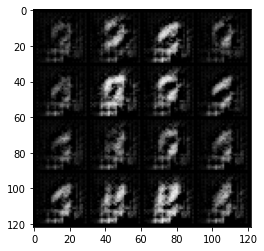

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1000: Generator loss: 1.8217378854751587, discriminator loss: 0.36626553535461426


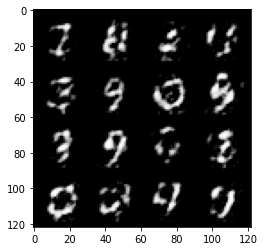

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1500: Generator loss: 1.3907392024993896, discriminator loss: 0.5138812065124512


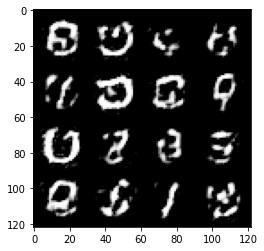

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2000: Generator loss: 1.4619364738464355, discriminator loss: 0.857524037361145


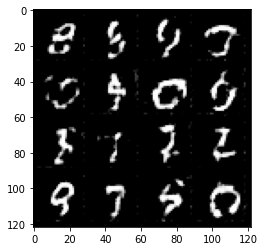

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2500: Generator loss: 2.721827983856201, discriminator loss: 1.2218945026397705


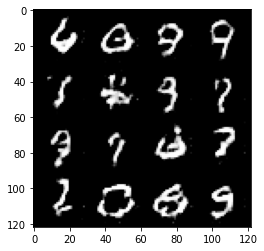

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 3000: Generator loss: 1.7611051797866821, discriminator loss: 0.5424127578735352


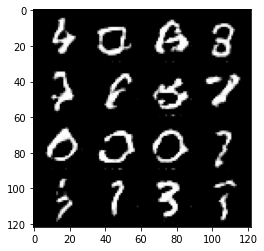

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 3500: Generator loss: 0.9937515258789062, discriminator loss: 0.7547836303710938


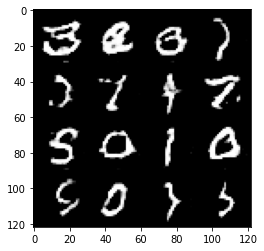



**************------>SAVING CheckPoint<--------*************
Checkpoint Directory exists! 
Saved DCGAN at epoch 7 to ./ckpts/DCGAN_epoch_7.pth.tar.


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 4000: Generator loss: 0.8969299793243408, discriminator loss: 1.0881038904190063


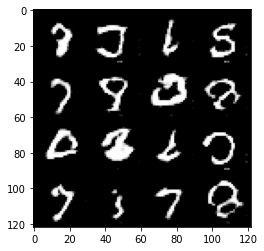

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 4500: Generator loss: 1.042171835899353, discriminator loss: 0.8059977889060974


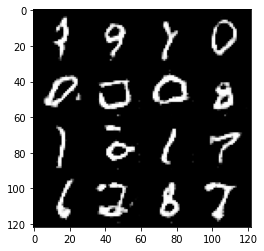

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 5000: Generator loss: 1.669653058052063, discriminator loss: 0.7721279859542847


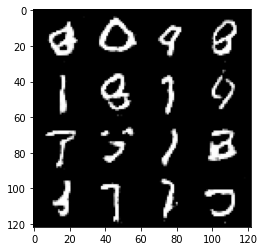

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 5500: Generator loss: 1.2962238788604736, discriminator loss: 0.6907635927200317


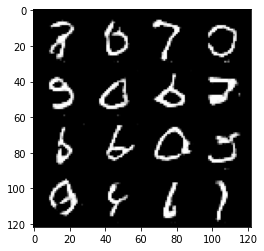

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 6000: Generator loss: 1.2961294651031494, discriminator loss: 0.7490586638450623


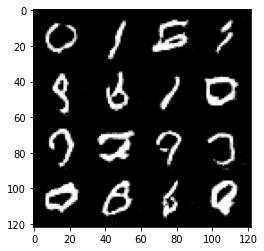

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 6500: Generator loss: 1.7185415029525757, discriminator loss: 0.8811048865318298


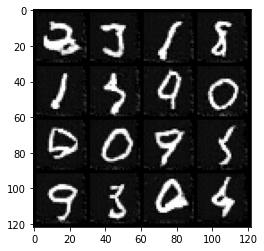

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 7000: Generator loss: 1.5737959146499634, discriminator loss: 0.922335684299469


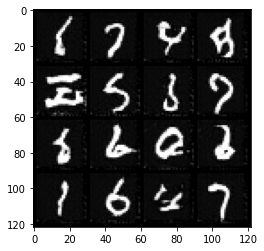

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 7500: Generator loss: 1.1049317121505737, discriminator loss: 1.0042877197265625


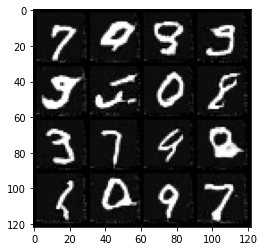



**************------>SAVING CheckPoint<--------*************
Checkpoint Directory exists! 
Saved DCGAN at epoch 15 to ./ckpts/DCGAN_epoch_15.pth.tar.


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 8000: Generator loss: 1.2817683219909668, discriminator loss: 0.8229576349258423


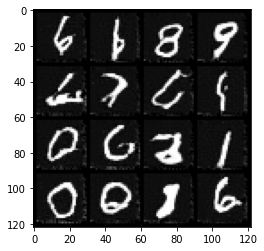

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 8500: Generator loss: 1.330631136894226, discriminator loss: 0.7757173776626587


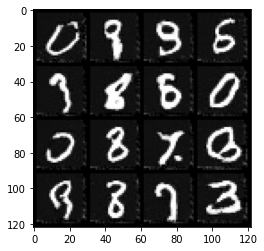

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 9000: Generator loss: 1.3637772798538208, discriminator loss: 0.7965081334114075


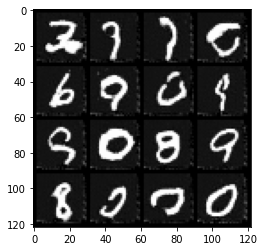

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 9500: Generator loss: 1.223398208618164, discriminator loss: 0.882479190826416


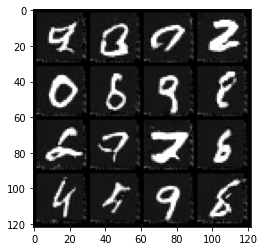

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 10000: Generator loss: 1.2213739156723022, discriminator loss: 0.8255817294120789


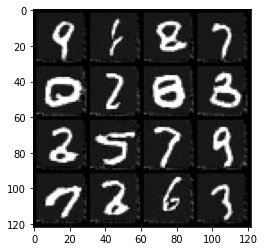

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 10500: Generator loss: 1.064199686050415, discriminator loss: 0.9592432379722595


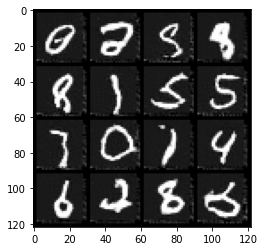

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 11000: Generator loss: 1.441949725151062, discriminator loss: 0.7759441137313843


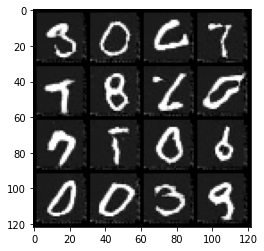



**************------>SAVING CheckPoint<--------*************
Checkpoint Directory exists! 
Saved DCGAN at epoch 23 to ./ckpts/DCGAN_epoch_23.pth.tar.


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 11500: Generator loss: 1.2533719539642334, discriminator loss: 0.8648170232772827


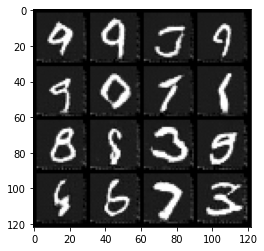

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 12000: Generator loss: 1.4360201358795166, discriminator loss: 0.762058436870575


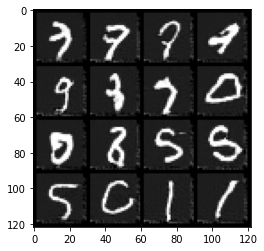

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 12500: Generator loss: 1.352501630783081, discriminator loss: 0.7487164735794067


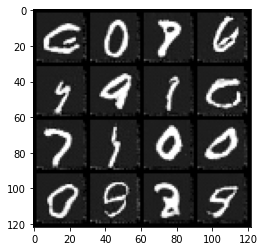

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 13000: Generator loss: 1.4368550777435303, discriminator loss: 0.8543932437896729


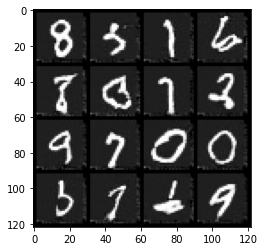

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 13500: Generator loss: 1.3607720136642456, discriminator loss: 0.881690263748169


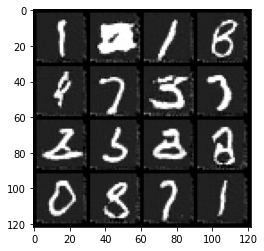

Step 14000: Generator loss: 1.2222518920898438, discriminator loss: 0.9613584280014038


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


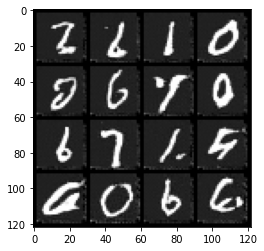

In [23]:
cur_step = 0 
display_step = 500
epochs_per_save = 8
#gen_loss_meter = meter.AverageValueMeter()
#disc_loss_meter = meter.AverageValueMeter()

gen_loss_fn = GeneratorLoss()
disc_loss_fn = DiscriminatorLoss()

ckpt_dir = './ckpts'
G_losses = []
D_losses = []
img_list = []
for epoch in range(hyper_param["num_epochs"]):
    # Dataloader returns the batches
    for real, _ in tqdm(train_loader):
        cur_batch_size = len(real)
        real = real.to(device)

        ## Update Discriminator ##
        disc_opt.zero_grad()
        z = torch.randn(cur_batch_size,hyper_param["z_dim"],1,1,device=device)#fake
        fake = gen(z)
        err_real,err_fake  = disc_loss_fn(real, fake, disc,cur_batch_size)
              
        # Update gradients
        err_real.backward()
        err_fake.backward()

        # Keep track of the average discriminator loss
        errD = err_real + err_fake
        #disc_loss_meter.add(errD.item())
        # Update optimizer
        disc_opt.step()

        ## Update Generator ##
        gen_opt.zero_grad()
        gen_loss = gen_loss_fn(fake, disc,cur_batch_size)
        gen_loss.backward()
        gen_opt.step()

        # Keep track of the average generator loss
        #gen_loss_meter.add(gen_loss.item())
        G_losses.append(gen_loss.item())
        D_losses.append(errD.item())

        ## Visualization code ##
        if cur_step % display_step == (display_step-1):
            print(f"Step {cur_step+1}: Generator loss: {gen_loss.item()}, discriminator loss: {errD.item()}")
            #print(f"Step {cur_step}: Generator loss: {gen_loss_meter.value()[0]}, discriminator loss: {disc_loss_meter.value()[0]}")
            with torch.no_grad():
                fake = gen(z).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

            #writer.add_scalar("gen_loss", gen_loss_meter.value()[0], cur_step)
            #writer.add_scalar("disc_loss", disc_loss_meter.value()[0], cur_step)
            writer.add_scalar("gen_loss", gen_loss.item(), cur_step)
            writer.add_scalar("disc_loss", errD.item(), cur_step)
            grid_fake = torchvision.utils.make_grid(fake[:16].detach(), nrow=4, padding=2)
            grid_real = torchvision.utils.make_grid(real[:16].detach(), nrow=4, padding=2)
            writer.add_image('fake', grid_fake, cur_step)
            writer.add_image('real', grid_real, cur_step)
            plt.imshow(grid_fake.cpu().permute(1, 2, 0).squeeze())
            plt.show()
            #show_tensor_images(real)
            #show_tensor_images(fake)
            #gen_loss_meter.reset()
            #disc_loss_meter.reset()
        cur_step += 1

    disc_scheduler.step(errD)
    gen_scheduler.step()

    if epoch % epochs_per_save == (epochs_per_save-1):
      print("\n","="*30)
      print("**************------>SAVING CheckPoint<--------*************")
      state = {  'epoch': epoch + 1,
                'gen_state_dir': gen.state_dict(),
                'gen_optimizer': gen_opt.state_dict(),
                'disc_optimizer': disc_opt.state_dict(),
                'gen_scheduler' : gen_scheduler.state_dict(),
                'disc_scheduler' : disc_scheduler.state_dict(),
                'gen_losses': G_losses,
                'disc_losses':D_losses,
               }
      save_checkpoint("DCGAN",ckpt_dir,state)

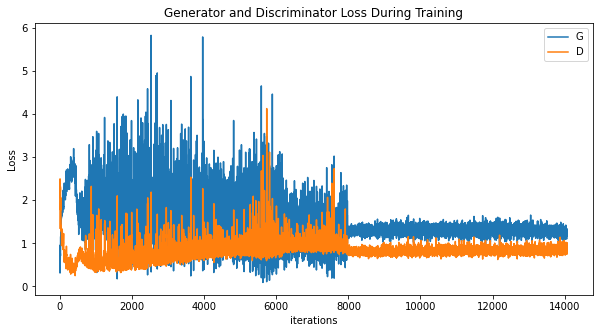

In [24]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

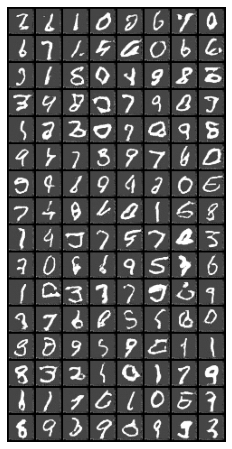

In [25]:
#%%capture
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

In [26]:
%reload_ext tensorboard
%tensorboard --logdir ./runs/ --samples_per_plugin images=100

<IPython.core.display.Javascript object>

# Load the trained model

In [58]:
checkpoint,model = load_checkpoint("./ckpts/DCGAN_epoch_23.pth.tar","gen",gen)

# Before
Randomly initalized Generator

torch.Size([128, 1, 28, 28])
Nothing Meaningful, Makes sense


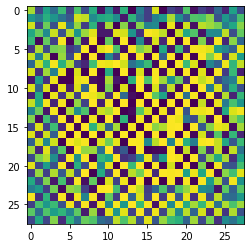

In [69]:
noise = torch.randn(128,100,1,1) #(batch,z_dim,1,1)
gen_shape_test = Generator()
generated_sample = gen_shape_test(noise)
print(generated_sample.shape)
plt.imshow(np.transpose(generated_sample[0].cpu().detach().numpy(),(1,2,0)).squeeze());
print("Nothing Meaningful, Makes sense")


# After
Trained generator(learned parameters through training)

torch.Size([1, 1, 28, 28])


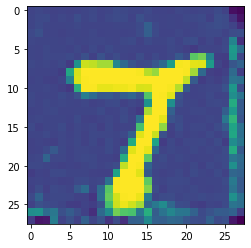

In [74]:
noise = torch.randn(1,100,1,1) #(batch,z_dim,1,1)
generated_sample = model(noise.to(device))#USing saved model
print(generated_sample.shape)
#print(generated_sample.shape)
plt.imshow(np.transpose(generated_sample[0].cpu().detach().numpy(),(1,2,0)).squeeze());